# Plotting Predictions

In this notebook, we use the snow depth predictions made in the previous notebook, to create visuals representing change in snow depth over time.

### Setup: Imports and download predictions

In [1]:
import pandas as pd

import helpers
import plotting

/usr/local/lib/python3.12/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
!aws s3 cp s3://aimees-snow-project/predictions.parquet predictions.parquet 

download: s3://aimees-snow-project/predictions.parquet to ./predictions.parquet


In [3]:
results_df = pd.read_parquet('predictions.parquet')

### Select max pixel per day

Reduce overlapping pixels by grouping data values by day, latitude, and longitude. Aggregate by the highest value for that pixel for that day. This only removes a small number of pixels.

In [4]:
max_by_day = results_df.groupby(['year', 'month', 'day', 'latitude', 'longitude']).agg({'snow_depth_prediction': 'max'}).reset_index(level=[3,4])

### Check each day has pixels that cover the entire polygon

In [5]:
%%time
crystal_polygon = helpers.get_ski_polygon('Crystal Mountain')

for daily_index in max_by_day.index.unique():
    rows = max_by_day.loc[daily_index]
    coverage_percentage = helpers.check_daily_coverage(rows, crystal_polygon)
    if coverage_percentage < 99:
        print(f"Day {daily_index} has {coverage_percentage}% coverage")
        # We can remove from group if <99% coverage, but not the case so far

CPU times: user 2min 59s, sys: 566 ms, total: 2min 59s
Wall time: 2min 59s


### Add snow season

In [6]:
%%time

# Apply to your DataFrame
max_by_day = max_by_day.reset_index()
max_by_day['snow_season'] = max_by_day.apply(lambda row: helpers.get_snow_season(row['month'], row['year']), axis=1)

# Filter to only snow season months and group
snow_season_data = max_by_day[max_by_day['snow_season'].notna()]

CPU times: user 1min 21s, sys: 1.53 s, total: 1min 23s
Wall time: 1min 23s


### Remove seasons with less than 6 months

In [7]:
season_month_counts = snow_season_data.groupby('snow_season')['month'].nunique()

# Get seasons that have all 6 months
complete_seasons = season_month_counts[season_month_counts == 6].index

# Filter the original DataFrame to keep only complete seasons
df_filtered = snow_season_data[snow_season_data['snow_season'].isin(complete_seasons)]

### Calculate average for each month for each latititude and longitude

In [8]:
avg_pixel_months = df_filtered.groupby(['year', 'month', 'latitude', 'longitude', 'snow_season']).agg({'snow_depth_prediction': 'mean'})
avg_pixel_months = avg_pixel_months.reset_index()

### Sum the average monthly pixels over latitude, longitude and snow season

In [9]:
avg_pixel_season_sum = avg_pixel_months.groupby(['snow_season', 'latitude', 'longitude']).agg({'snow_depth_prediction': 'sum'}).reset_index()

### Plot the sum over the season for each pixel (lat/lon point) average

In [10]:
plotting.create_season_maps_grid(avg_pixel_season_sum)

### Sum and plot all average monthly lat/lon values over the snow season

<Axes: xlabel='snow_season'>

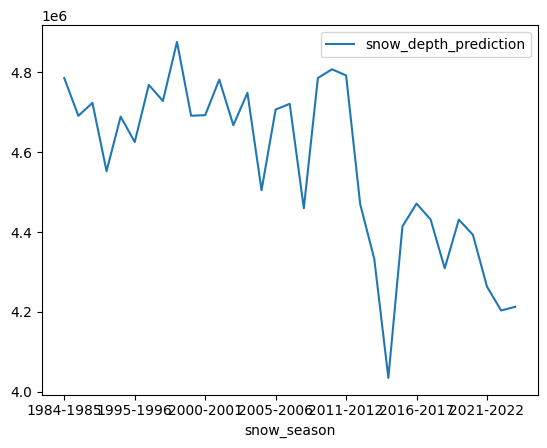

In [11]:
avg_pixel_months.groupby(['snow_season']).agg({'snow_depth_prediction': 'sum'}).plot()